<a href="https://colab.research.google.com/github/RoboTuan/FPAR/blob/master/RUNProject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Project

In [1]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Subset, DataLoader
from torch.backends import cudnn
import tensorflow as tf
import datetime
import numpy as np
import time
import matplotlib.pyplot as plt
import seaborn as sns
from torch.autograd import Function
import torchvision
from torchvision.models import alexnet
from torchvision.utils import make_grid
from sklearn.model_selection import RandomizedSearchCV
import pandas.util.testing as tm
from PIL import Image
from tqdm.notebook import tqdm

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:20: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.


In [2]:
!nvidia-smi

Tue Dec 29 12:45:57 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.27.04    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P8     8W /  75W |      0MiB /  7611MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!unzip -q "./drive/My Drive/GTEA61.zip"
!rm -rf "./__MACOSX"

In [14]:
!rm -rf "./ML_DL_Project"

In [2]:
import os 
if not os.path.isdir('./ML_DL_Project'):
  !git clone https://github.com/RoboTuan/ML_DL_Project.git

Cloning into 'ML_DL_Project'...
remote: Enumerating objects: 263, done.
remote: Counting objects: 100% (263/263), done.
remote: Compressing objects: 100% (252/252), done.
remote: Total 793 (delta 179), reused 25 (delta 11), pack-reused 530
Receiving objects: 100% (793/793), 92.95 MiB | 10.02 MiB/s, done.
Resolving deltas: 100% (534/534), done.


In [7]:
base_dataset = "./GTEA61"

if not os.path.isdir('./GTEA61_val'):
  os.makedirs("./GTEA61_val")
  os.makedirs("./GTEA61_val/flow_x_processed")
  os.makedirs("./GTEA61_val/flow_y_processed")
  os.makedirs("./GTEA61_val/processed_frames2")
  pass


for directory in sorted(os.listdir(base_dataset)):
  if not directory.startswith('.'):
    directory_path = os.path.join(base_dataset, directory)
    new_directory_path = os.path.join("./GTEA61_val", directory)

    for user in sorted(os.listdir(directory_path)):
      if not user.startswith('.') and user == "S2":
        current_folder = os.path.join(directory_path, user)
        !cp -r "{current_folder}" "{new_directory_path}"
        !rm -rf "{current_folder}"
        print(current_folder)


./GTEA61/flow_x_processed/S2
./GTEA61/flow_y_processed/S2
./GTEA61/processed_frames2/S2


In [3]:
import ML_DL_Project.Scripts.main_run_rgb as mrr
import ML_DL_Project.Scripts.main_run_flow as mrf
import ML_DL_Project.Scripts.main_run_twoStream as mr2s
import ML_DL_Project.Scripts.main_run_selfSup as mrSS
import ML_DL_Project.Scripts.eval_run_rgb as rb
import ML_DL_Project.Scripts.eval_run_flow as rf
import ML_DL_Project.Scripts.eval_run_twoStream_joint as tsj
import ML_DL_Project.Scripts.eval_run_ss as ss
import argparse

In [4]:
!rm -rf "./experiments"
!rm -rf "./outDir"

## Simple RGB run

### First stage without attention

In [ ]:
%reload_ext tensorboard
#!rm -rf ./outDir/

In [ ]:
stage1_noAtt = ["--trainDatasetDir", "./GTEA61",
                "--outDir", "outDir",
                "--valDatasetDir", "./GTEA61_val",
                "--numEpochs", "200",
                "--lr", "1e-3",
                "--seqLen", "16",
                "--memSize", "512",
                #"--stepSize", ["25", "75", "150"],
                "--decayRate", "0.1",
                "--attention", False]


mrr.__main__(stage1_noAtt)

Train: Epoch = 1 | Loss = 4.900224729017778 | Accuracy = 3.51906156539917
Val: Epoch = 1 | Loss 3.990174174308777 | Accuracy = 6.034482479095459
Train: Epoch = 2 | Loss = 4.058987379074097 | Accuracy = 2.932551383972168
Val: Epoch = 2 | Loss 3.953217029571533 | Accuracy = 6.034482479095459
Train: Epoch = 3 | Loss = 4.023713697086681 | Accuracy = 5.865102767944336
Val: Epoch = 3 | Loss 3.908578038215637 | Accuracy = 6.034482479095459
Train: Epoch = 4 | Loss = 4.001126332716509 | Accuracy = 5.278592586517334
Val: Epoch = 4 | Loss 3.8976584672927856 | Accuracy = 6.034482479095459
Train: Epoch = 5 | Loss = 3.9419880346818403 | Accuracy = 5.278592586517334
Val: Epoch = 5 | Loss 3.85610830783844 | Accuracy = 7.758620262145996
Train: Epoch = 6 | Loss = 3.976059328426014 | Accuracy = 6.45161247253418
Val: Epoch = 6 | Loss 3.8468997478485107 | Accuracy = 6.034482479095459
Train: Epoch = 7 | Loss = 3.9356413971294057 | Accuracy = 5.865102767944336
Val: Epoch = 7 | Loss 3.8154067993164062 | Accur

### Second stage without attention

In [ ]:
#!rm -rf ./outDir/gtea61/rgb_noAttention/stage2

In [ ]:
stage2_noAtt = ["--trainDatasetDir", "./GTEA61",
           "--outDir", "outDir",
          "--valDatasetDir", "./GTEA61_val",
          "--lr", "1e-4",
          "--seqLen", "16",
          "--numEpochs", "150",
          "--stage", "2",
          "--stage1Dict", "./outDir/gtea61/rgb_noAttention/stage1/model_rgb_state_dict.pth",
          "--attention", False]

mrr.__main__(stage2_noAtt)

Train: Epoch = 1 | Loss = 3.9893351684917104 | Accuracy = 7.03812313079834
Val: Epoch = 1 | Loss 3.908194661140442 | Accuracy = 6.034482479095459
Train: Epoch = 2 | Loss = 3.9456263888965952 | Accuracy = 6.158357620239258
Val: Epoch = 2 | Loss 3.8719284534454346 | Accuracy = 6.034482479095459
Train: Epoch = 3 | Loss = 3.897501078518954 | Accuracy = 7.917888641357422
Val: Epoch = 3 | Loss 3.7920013666152954 | Accuracy = 9.482758522033691


In [ ]:
%tensorboard --logdir=outDir/gtea61/rgb_noAttention

<IPython.core.display.Javascript object>

Number of samples = 116
Evaluating...
Test Accuracy = 47.41379165649414%
[tensor([0]), tensor([1]), tensor([1]), tensor([2]), tensor([2]), tensor([3]), tensor([4]), tensor([5]), tensor([6]), tensor([6]), tensor([7]), tensor([7]), tensor([8]), tensor([8]), tensor([9]), tensor([9]), tensor([9]), tensor([10]), tensor([11]), tensor([12]), tensor([13]), tensor([13]), tensor([14]), tensor([14]), tensor([15]), tensor([16]), tensor([17]), tensor([18]), tensor([18]), tensor([19]), tensor([19]), tensor([20]), tensor([20]), tensor([21]), tensor([22]), tensor([22]), tensor([22]), tensor([23]), tensor([24]), tensor([24]), tensor([24]), tensor([24]), tensor([25]), tensor([26]), tensor([27]), tensor([28]), tensor([29]), tensor([30]), tensor([31]), tensor([31]), tensor([31]), tensor([31]), tensor([32]), tensor([32]), tensor([32]), tensor([33]), tensor([33]), tensor([34]), tensor([35]), tensor([36]), tensor([37]), tensor([37]), tensor([37]), tensor([37]), tensor([38]), tensor([39]), tensor([39]), tenso

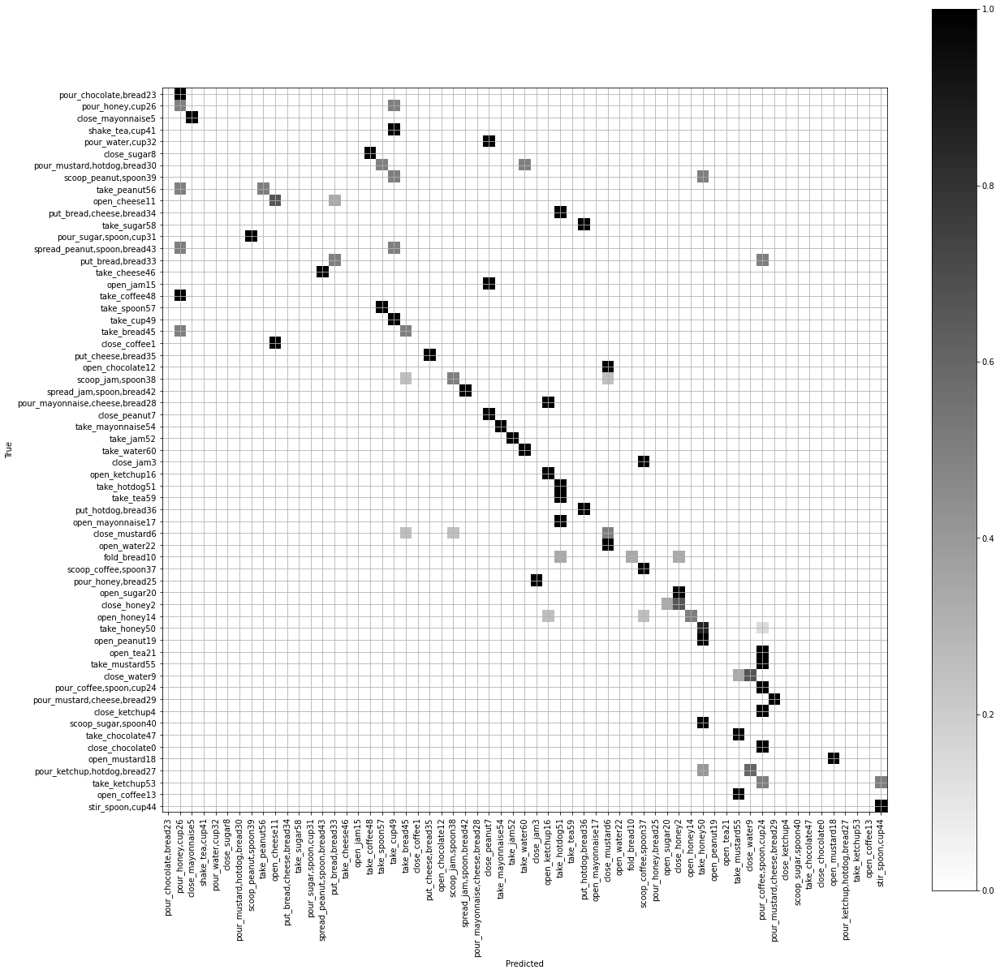

In [16]:
elements = ["--datasetDir", "./GTEA61_val",
            "--modelStateDict", "./7FramesNoAttention/model_rgb_state_dict(1).pth",
            "--seqLen", "7",
           "--attention", False]
rb.__main__(elements)

Number of samples = 116
Evaluating...
Test Accuracy = 56.034481048583984%
[tensor([0]), tensor([1]), tensor([1]), tensor([2]), tensor([2]), tensor([3]), tensor([4]), tensor([5]), tensor([6]), tensor([6]), tensor([7]), tensor([7]), tensor([8]), tensor([8]), tensor([9]), tensor([9]), tensor([9]), tensor([10]), tensor([11]), tensor([12]), tensor([13]), tensor([13]), tensor([14]), tensor([14]), tensor([15]), tensor([16]), tensor([17]), tensor([18]), tensor([18]), tensor([19]), tensor([19]), tensor([20]), tensor([20]), tensor([21]), tensor([22]), tensor([22]), tensor([22]), tensor([23]), tensor([24]), tensor([24]), tensor([24]), tensor([24]), tensor([25]), tensor([26]), tensor([27]), tensor([28]), tensor([29]), tensor([30]), tensor([31]), tensor([31]), tensor([31]), tensor([31]), tensor([32]), tensor([32]), tensor([32]), tensor([33]), tensor([33]), tensor([34]), tensor([35]), tensor([36]), tensor([37]), tensor([37]), tensor([37]), tensor([37]), tensor([38]), tensor([39]), tensor([39]), tens

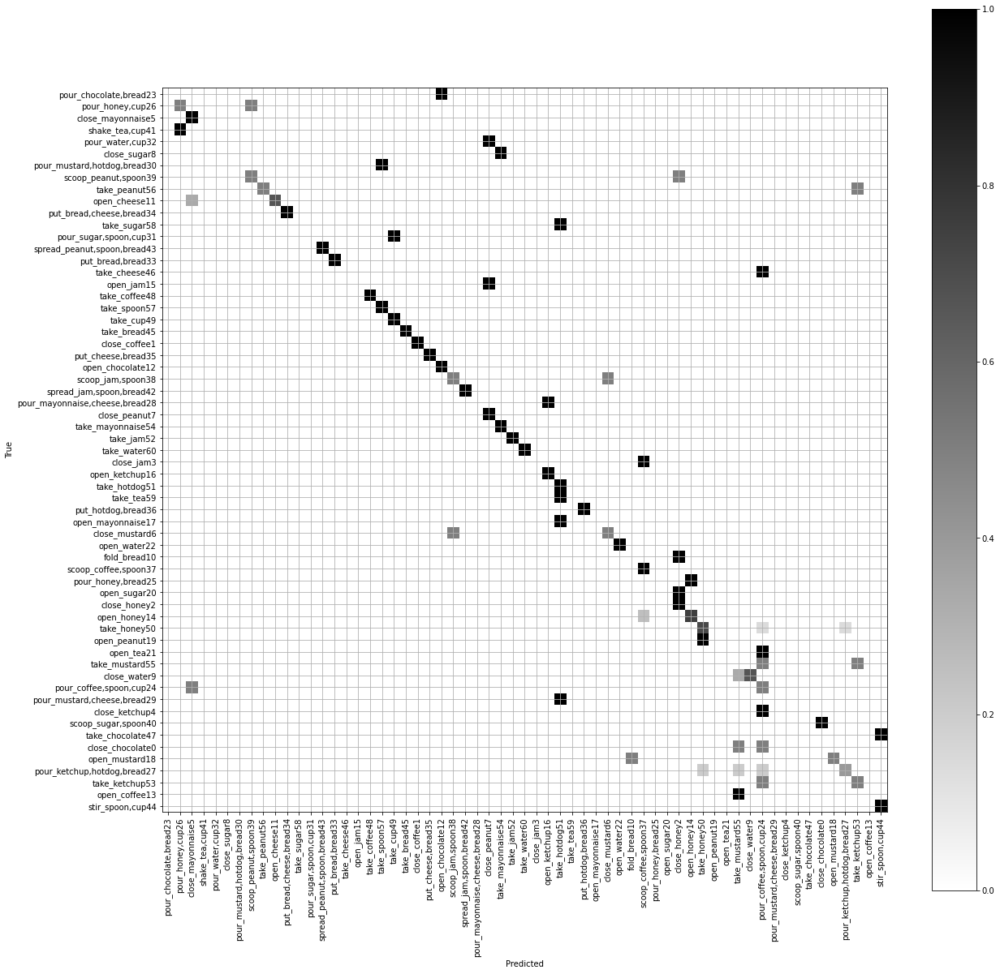

In [17]:
elements = ["--datasetDir", "./GTEA61_val",
            "--modelStateDict", "./16FramesRGB_noAttention/model_rgb_state_dict (1).pth",
            "--seqLen", "16",
           "--attention", False]
rb.__main__(elements)

### First stage with attention

In [ ]:
%reload_ext tensorboard

In [ ]:
stage1 = ["--trainDatasetDir", "./GTEA61",
          "--outDir", "outDir",
          "--valDatasetDir", "./GTEA61_val",
          "--numEpochs", "3",
          "--lr", "1e-3",
          "--seqLen", "7",
          "--memSize", "512",
          #"--stepSize", ["25", "75", "150"],
          "--decayRate", "0.1",]


mrr.__main__(stage1)

#mrr.main_run("gtea61", 1, "./GTEA61", "./GTEA61_val", None, "/yolo", 7, 32, 64, 3, 1e-3, 0.1, [25, 75, 150], 512, True)

Train: Epoch = 1 | Loss = 4.077443426305598 | Accuracy = 4.985337257385254
Val: Epoch = 1 | Loss 3.9652416706085205 | Accuracy = 6.034482479095459
Train: Epoch = 2 | Loss = 4.047680161216042 | Accuracy = 4.692081928253174
Val: Epoch = 2 | Loss 3.9216114282608032 | Accuracy = 6.034482479095459
Train: Epoch = 3 | Loss = 3.971658554944125 | Accuracy = 5.571847438812256
Val: Epoch = 3 | Loss 3.8638553619384766 | Accuracy = 6.896551609039307


### Second stage with attention

In [ ]:
stage2 = ["--trainDatasetDir", "./GTEA61",
           "--outDir", "outDir",
          "--valDatasetDir", "./GTEA61_val",
          "--lr", "1e-3",
          "--seqLen", "7",
          "--numEpochs", "3",
          "--stage", "2",
          "--stage1Dict", "./outDir/gtea61/rgb/stage1/model_rgb_state_dict.pth"]

mrr.__main__(stage2)

Train: Epoch = 1 | Loss = 4.053952390497381 | Accuracy = 4.398827075958252
Val: Epoch = 1 | Loss 3.949112892150879 | Accuracy = 6.034482479095459
Train: Epoch = 2 | Loss = 4.031967466527766 | Accuracy = 2.052785873413086
Val: Epoch = 2 | Loss 3.967130661010742 | Accuracy = 6.034482479095459
Train: Epoch = 3 | Loss = 4.024827545339411 | Accuracy = 6.158357620239258
Val: Epoch = 3 | Loss 3.943656802177429 | Accuracy = 6.034482479095459


In [ ]:
%tensorboard --logdir=outDir/gtea61/rgb

Number of samples = 116
Evaluating...
Test Accuracy = 56.034481048583984%
[tensor([0]), tensor([1]), tensor([1]), tensor([2]), tensor([2]), tensor([3]), tensor([4]), tensor([5]), tensor([6]), tensor([6]), tensor([7]), tensor([7]), tensor([8]), tensor([8]), tensor([9]), tensor([9]), tensor([9]), tensor([10]), tensor([11]), tensor([12]), tensor([13]), tensor([13]), tensor([14]), tensor([14]), tensor([15]), tensor([16]), tensor([17]), tensor([18]), tensor([18]), tensor([19]), tensor([19]), tensor([20]), tensor([20]), tensor([21]), tensor([22]), tensor([22]), tensor([22]), tensor([23]), tensor([24]), tensor([24]), tensor([24]), tensor([24]), tensor([25]), tensor([26]), tensor([27]), tensor([28]), tensor([29]), tensor([30]), tensor([31]), tensor([31]), tensor([31]), tensor([31]), tensor([32]), tensor([32]), tensor([32]), tensor([33]), tensor([33]), tensor([34]), tensor([35]), tensor([36]), tensor([37]), tensor([37]), tensor([37]), tensor([37]), tensor([38]), tensor([39]), tensor([39]), tens

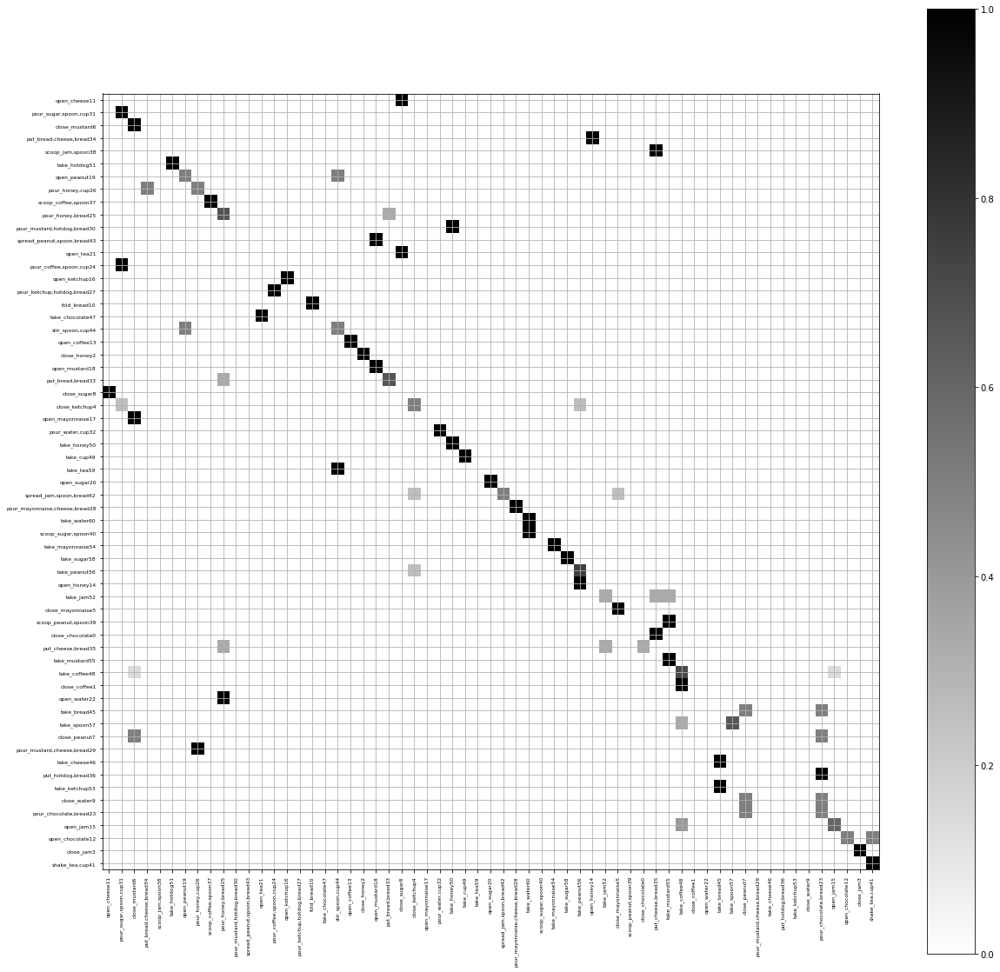

In [ ]:
elements = ["--datasetDir", "./GTEA61_val",
            "--modelStateDict", "./7FramesRGB_Attention/model_rgb_state_dict(1).pth",
            "--seqLen", "7"]
rb.__main__(elements)

Number of samples = 116
Evaluating...
Test Accuracy = 62.06896209716797%
[tensor([0]), tensor([1]), tensor([1]), tensor([2]), tensor([2]), tensor([3]), tensor([4]), tensor([5]), tensor([6]), tensor([6]), tensor([7]), tensor([7]), tensor([8]), tensor([8]), tensor([9]), tensor([9]), tensor([9]), tensor([10]), tensor([11]), tensor([12]), tensor([13]), tensor([13]), tensor([14]), tensor([14]), tensor([15]), tensor([16]), tensor([17]), tensor([18]), tensor([18]), tensor([19]), tensor([19]), tensor([20]), tensor([20]), tensor([21]), tensor([22]), tensor([22]), tensor([22]), tensor([23]), tensor([24]), tensor([24]), tensor([24]), tensor([24]), tensor([25]), tensor([26]), tensor([27]), tensor([28]), tensor([29]), tensor([30]), tensor([31]), tensor([31]), tensor([31]), tensor([31]), tensor([32]), tensor([32]), tensor([32]), tensor([33]), tensor([33]), tensor([34]), tensor([35]), tensor([36]), tensor([37]), tensor([37]), tensor([37]), tensor([37]), tensor([38]), tensor([39]), tensor([39]), tenso

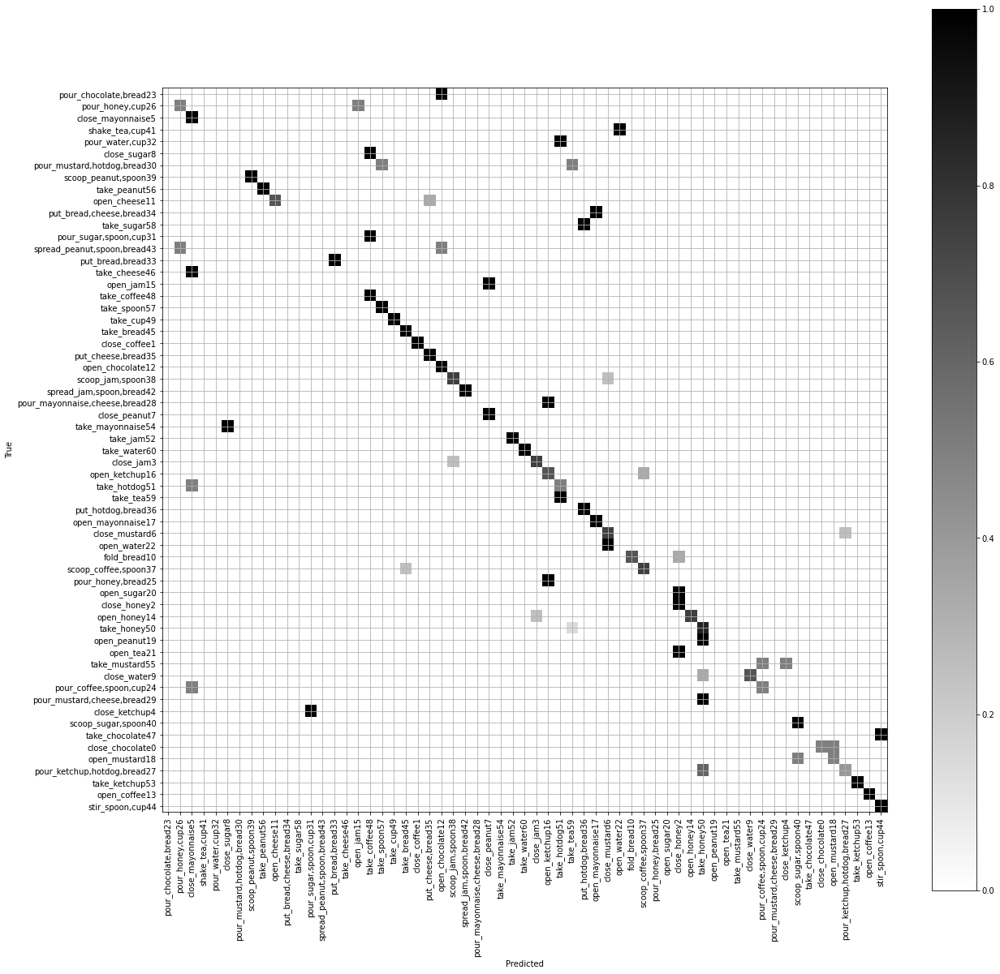

In [19]:
elements = ["--datasetDir", "./GTEA61_val",
            "--modelStateDict", "./16FramesRGB_Attention/model_rgb_state_dict (1).pth",
            "--seqLen", "16"]
rb.__main__(elements)

## Warp flow

In [ ]:
%reload_ext tensorboard
#!rm -rf ./outDir/gtea61/flow

In [ ]:
flow = ["--trainDatasetDir", "./GTEA61",
      "--outDir", "outDir",
      "--valDatasetDir", "./GTEA61_val",
      "--stackSize", "5",
      "--numEpochs", "3",
]
mrf.__main__(flow)

Number of samples in the dataset: training = 341 | validation = 116
Train: Epoch = 1 | Loss = 4.512066581032493 | Accuracy = 3.22580623626709
Validation: Epoch = 1 | Loss = 4.184394836425781 | Accuracy = 1.7241379022598267
Train: Epoch = 2 | Loss = 4.4370974193919785 | Accuracy = 4.985337257385254
Validation: Epoch = 2 | Loss = 4.240435183048248 | Accuracy = 5.1724138259887695
Train: Epoch = 3 | Loss = 4.367075053128329 | Accuracy = 2.932551383972168
Validation: Epoch = 3 | Loss = 4.785077095031738 | Accuracy = 0.0


In [ ]:
%tensorboard --logdir=outDir/gtea61/flow

<IPython.core.display.Javascript object>

Number of samples = 116
Evaluating...
Test Accuracy  = 47.41379165649414%


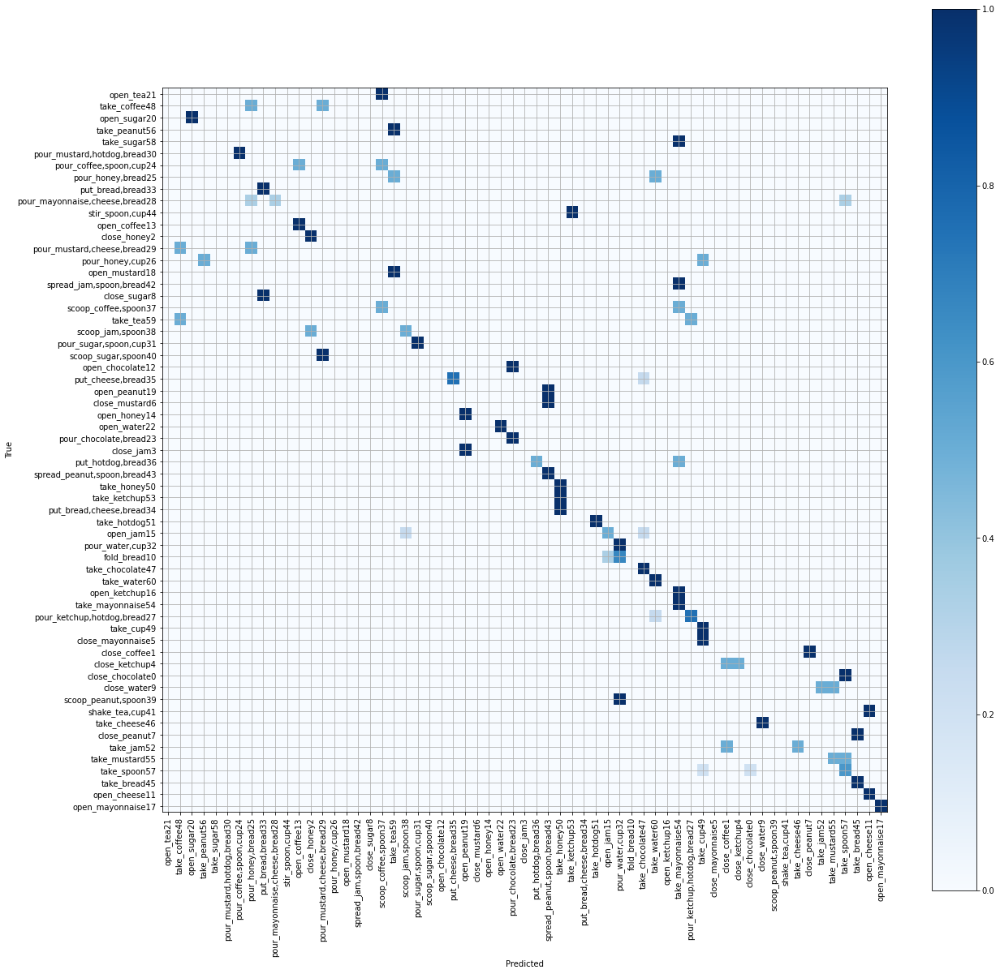

In [5]:
elements = ["--datasetDir", "./GTEA61_val",
            "--modelStateDict", "./WarpFlow/model_flow_state_dict.pth"]
rf.__main__(elements)

## Two stream

In [ ]:
%reload_ext tensorboard
#!rm -rf ./outDir/gtea61/twoStream

In [ ]:
two_stream = ["--trainDatasetDir", "./GTEA61",
              "--outDir", "outDir",
              "--valDatasetDir", "./GTEA61_val",
              "--stackSize", "5",
              "--seqLen", "7",
              "--numEpochs", "3",
              "--flowModel", "./outDir/gtea61/flow/model_flow_state_dict.pth",
              "--rgbModel", "./outDir/gtea61/rgb/stage2/model_rgb_state_dict.pth",  
]

mr2s.__main__(two_stream)

Average training loss after 1 epoch = 4.310545986348933 
Training accuracy after 1 epoch = 2.346040964126587% 
Val Loss after 1 epochs, loss = 4.12221747636795
Val Accuracy after 1 epochs = 2.5862069129943848%
Average training loss after 2 epoch = 4.3281142928383565 
Training accuracy after 2 epoch = 3.22580623626709% 
Val Loss after 2 epochs, loss = 4.092218518257141
Val Accuracy after 2 epochs = 5.1724138259887695%
Average training loss after 3 epoch = 4.3468921834772285 
Training accuracy after 3 epoch = 3.81231689453125% 
Val Loss after 3 epochs, loss = 4.131466567516327
Val Accuracy after 3 epochs = 6.034482479095459%


In [ ]:
%tensorboard --logdir=outDir/gtea61/twoStream

Number of samples = 116
Evaluating...
Accuracy 59.48%


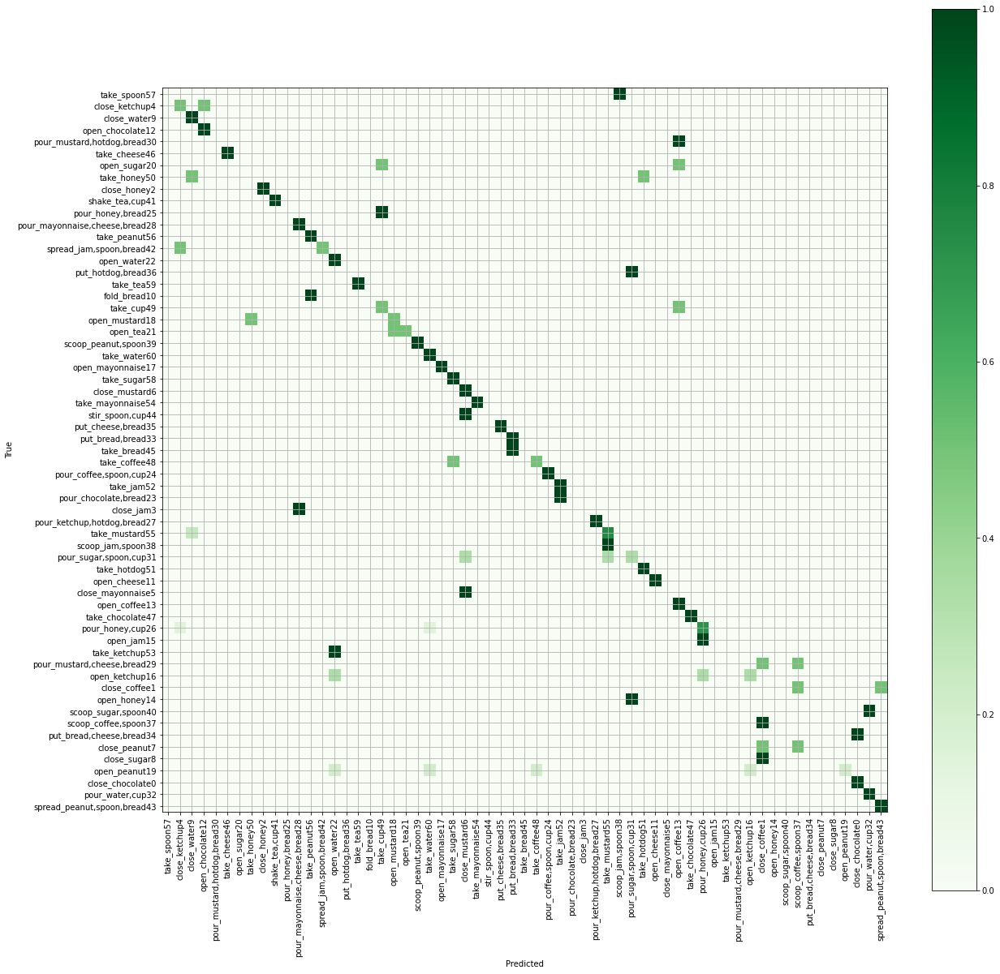

In [4]:
elements = ["--datasetDir", "./GTEA61_val",
            "--modelStateDict", "./TwoStream7Frames/model_twoStream_state_dict.pth",
            "--seqLen","7"]
tsj.__main__(elements)

Number of samples = 116
Evaluating...
Accuracy 62.07%


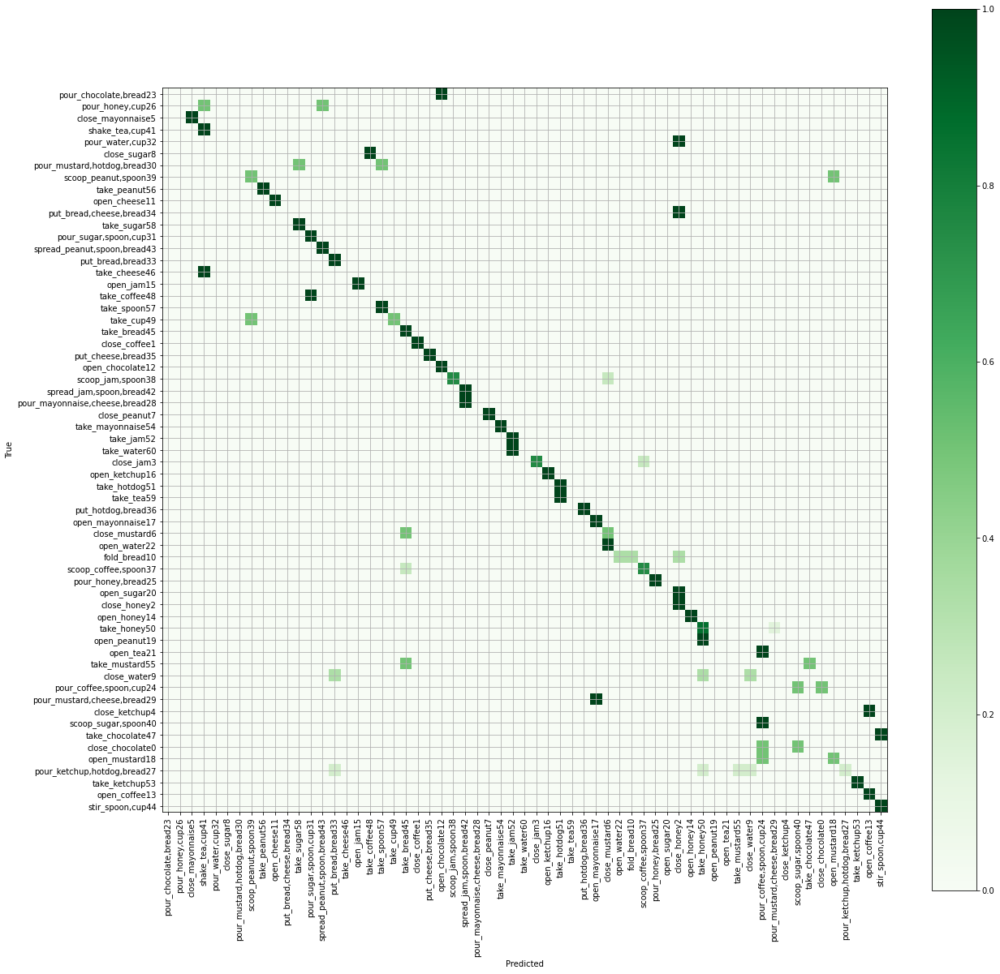

In [20]:
elements = ["--datasetDir", "./GTEA61_val",
            "--modelStateDict", "./TwoStream16Frames/model_twoStream_state_dict.pth",
            "--seqLen","16"]
tsj.__main__(elements)

## Self supervised task

In [ ]:
%reload_ext tensorboard
!rm -rf ./outDir/

In [ ]:
#!unzip -q "./drive/MyDrive/model_rgb_state_dict.pth" "./"

caution: filename not matched:  ./


In [ ]:
stage2_selfSup = ["--trainDatasetDir", "./GTEA61",
                  "--outDir", "outDir",
                  "--valDatasetDir", "./GTEA61_val",
                  "--lr", "2e-4",
                  "--seqLen", "7",
                  "--numEpochs", "150",
                  "--stage", "2",
                  "--pretrainedRgbStage1", "True",
                  "--rgbStage1Dict","./drive/MyDrive/model_rgb_state_dict.pth",
                  "--decayRate", "0.3"
                  ]

mrSS.__main__(stage2_selfSup)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth



Train: Epoch = 1 | Loss = 3.0033757903359155 | Accuracy = 24.926685333251953
Mmap loss after 1 epoch = 0.6271774281154979% 
Val: Epoch = 1 | Loss 2.784713625907898 | Accuracy = 23.275861740112305
Val MMap Loss after 1 epochs, loss = 0.48356013000011444
Train: Epoch = 2 | Loss = 2.7625336430289527 | Accuracy = 23.753665924072266
Mmap loss after 2 epoch = 0.32289486175233667% 
Val: Epoch = 2 | Loss 2.648792862892151 | Accuracy = 30.172412872314453
Val MMap Loss after 2 epochs, loss = 0.16907401382923126
Train: Epoch = 3 | Loss = 2.6591929739171807 | Accuracy = 30.49853515625
Mmap loss after 3 epoch = 0.1353020817041397% 
Val: Epoch = 3 | Loss 2.68656587600708 | Accuracy = 26.724138259887695
Val MMap Loss after 3 epochs, loss = 0.10625379160046577
Train: Epoch = 4 | Loss = 2.6036502664739434 | Accuracy = 26.68621826171875
Mmap loss after 4 epoch = 0.10036828910762613% 
Val: Epoch = 4 | Loss 2.4130241870880127 | Accuracy = 32.75862121582031
Val MMap Loss after 4 epochs, loss = 0.102031726

In [ ]:
!zip -r "cartella_selfSupGiro2_prova_1.zip" "./outDir/gtea61/selfSup"

  adding: outDir/gtea61/selfSup/ (stored 0%)
  adding: outDir/gtea61/selfSup/stage2/ (stored 0%)
  adding: outDir/gtea61/selfSup/stage2/val_log_loss.txt (deflated 74%)
  adding: outDir/gtea61/selfSup/stage2/val_log_acc.txt (deflated 92%)
  adding: outDir/gtea61/selfSup/stage2/train_log_loss.txt (deflated 74%)
  adding: outDir/gtea61/selfSup/stage2/train_log_acc.txt (deflated 87%)
  adding: outDir/gtea61/selfSup/stage2/events.out.tfevents.1608232676.6f393d8a54c6.56.2 (deflated 70%)
  adding: outDir/gtea61/selfSup/stage2/model_selfSup_state_dict.pth (deflated 7%)


In [ ]:
%tensorboard --logdir=outDir/gtea61/selfSup

Number of samples = 116
Evaluating...
Test Accuracy = 66.37931060791016%
[tensor([0]), tensor([1]), tensor([1]), tensor([2]), tensor([2]), tensor([3]), tensor([4]), tensor([5]), tensor([6]), tensor([6]), tensor([7]), tensor([7]), tensor([8]), tensor([8]), tensor([9]), tensor([9]), tensor([9]), tensor([10]), tensor([11]), tensor([12]), tensor([13]), tensor([13]), tensor([14]), tensor([14]), tensor([15]), tensor([16]), tensor([17]), tensor([18]), tensor([18]), tensor([19]), tensor([19]), tensor([20]), tensor([20]), tensor([21]), tensor([22]), tensor([22]), tensor([22]), tensor([23]), tensor([24]), tensor([24]), tensor([24]), tensor([24]), tensor([25]), tensor([26]), tensor([27]), tensor([28]), tensor([29]), tensor([30]), tensor([31]), tensor([31]), tensor([31]), tensor([31]), tensor([32]), tensor([32]), tensor([32]), tensor([33]), tensor([33]), tensor([34]), tensor([35]), tensor([36]), tensor([37]), tensor([37]), tensor([37]), tensor([37]), tensor([38]), tensor([39]), tensor([39]), tenso

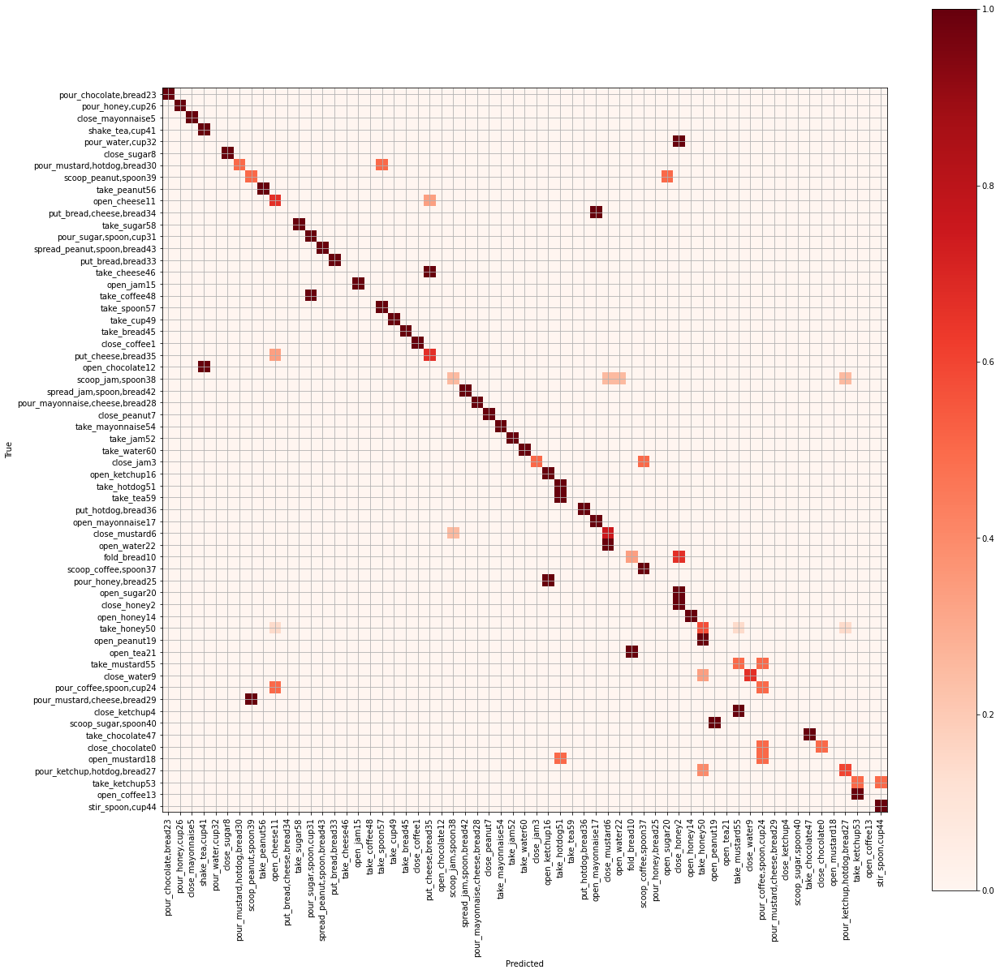

In [7]:
elements = ["--datasetDir", "./GTEA61_val",
            "--model_state_dict", "./outDir/gtea61/selfSup/stage2/model_selfSup_state_dict.pth",
            "--seqLen", "7",
            "--regression", False]
ss.__main__(elements)

## Self supervised task with regression


In [ ]:
%reload_ext tensorboard
#!rm -rf ./outDir/

In [ ]:
stage2_RegSelfSup = ["--trainDatasetDir", "./GTEA61",
                  "--outDir", "outDir",
                  "--valDatasetDir", "./GTEA61_val",
                  "--lr", "5e-5",
                  "--seqLen", "7",
                  "--numEpochs", "150",
                  "--stage", "2",
                  "--pretrainedRgbStage1", "True",
                  "--rgbStage1Dict","./drive/MyDrive/model_rgb_state_dict.pth",
                  "--regression", "True"]

mrSS.__main__(stage2_RegSelfSup)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth



Train: Epoch = 1 | Loss = 2.3862091302871704 | Accuracy = 34.60410690307617
Mmap loss after 1 epoch = 0.19188435849818317% 
Val: Epoch = 1 | Loss 2.4961626529693604 | Accuracy = 31.034481048583984
Val MMap Loss after 1 epochs, loss = 0.13514507189393044
Train: Epoch = 2 | Loss = 2.3213957114653154 | Accuracy = 35.48387145996094
Mmap loss after 2 epoch = 0.09862496365200389% 
Val: Epoch = 2 | Loss 2.679013729095459 | Accuracy = 31.89655303955078
Val MMap Loss after 2 epochs, loss = 0.11894743144512177
Train: Epoch = 3 | Loss = 2.3043394522233442 | Accuracy = 34.31085205078125
Mmap loss after 3 epoch = 0.0862463353709741% 
Val: Epoch = 3 | Loss 2.4790672063827515 | Accuracy = 35.344825744628906
Val MMap Loss after 3 epochs, loss = 0.10304722934961319
Train: Epoch = 4 | Loss = 2.33312650160356 | Accuracy = 32.55131912231445
Mmap loss after 4 epoch = 0.07805136455730959% 
Val: Epoch = 4 | Loss 2.3781869411468506 | Accuracy = 32.75862121582031
Val MMap Loss after 4 epochs, loss = 0.0968352

In [ ]:
%tensorboard --logdir=outDir/gtea61/regSelfSup

In [ ]:
!zip -r "cartella_RegselfSupGiro3_prova_3.zip" "./outDir/gtea61/regSelfSup"

  adding: outDir/gtea61/regSelfSup/ (stored 0%)
  adding: outDir/gtea61/regSelfSup/stage2/ (stored 0%)
  adding: outDir/gtea61/regSelfSup/stage2/events.out.tfevents.1608554097.f4121156f938.57.1 (deflated 70%)
  adding: outDir/gtea61/regSelfSup/stage2/val_log_loss.txt (deflated 74%)
  adding: outDir/gtea61/regSelfSup/stage2/val_log_acc.txt (deflated 91%)
  adding: outDir/gtea61/regSelfSup/stage2/train_log_loss.txt (deflated 74%)
  adding: outDir/gtea61/regSelfSup/stage2/train_log_acc.txt (deflated 83%)
  adding: outDir/gtea61/regSelfSup/stage2/model_selfSup_state_dict.pth (deflated 7%)


Number of samples = 116
Evaluating...
Test Accuracy = 63.79310607910156%
[tensor([0]), tensor([1]), tensor([1]), tensor([2]), tensor([2]), tensor([3]), tensor([4]), tensor([5]), tensor([6]), tensor([6]), tensor([7]), tensor([7]), tensor([8]), tensor([8]), tensor([9]), tensor([9]), tensor([9]), tensor([10]), tensor([11]), tensor([12]), tensor([13]), tensor([13]), tensor([14]), tensor([14]), tensor([15]), tensor([16]), tensor([17]), tensor([18]), tensor([18]), tensor([19]), tensor([19]), tensor([20]), tensor([20]), tensor([21]), tensor([22]), tensor([22]), tensor([22]), tensor([23]), tensor([24]), tensor([24]), tensor([24]), tensor([24]), tensor([25]), tensor([26]), tensor([27]), tensor([28]), tensor([29]), tensor([30]), tensor([31]), tensor([31]), tensor([31]), tensor([31]), tensor([32]), tensor([32]), tensor([32]), tensor([33]), tensor([33]), tensor([34]), tensor([35]), tensor([36]), tensor([37]), tensor([37]), tensor([37]), tensor([37]), tensor([38]), tensor([39]), tensor([39]), tenso

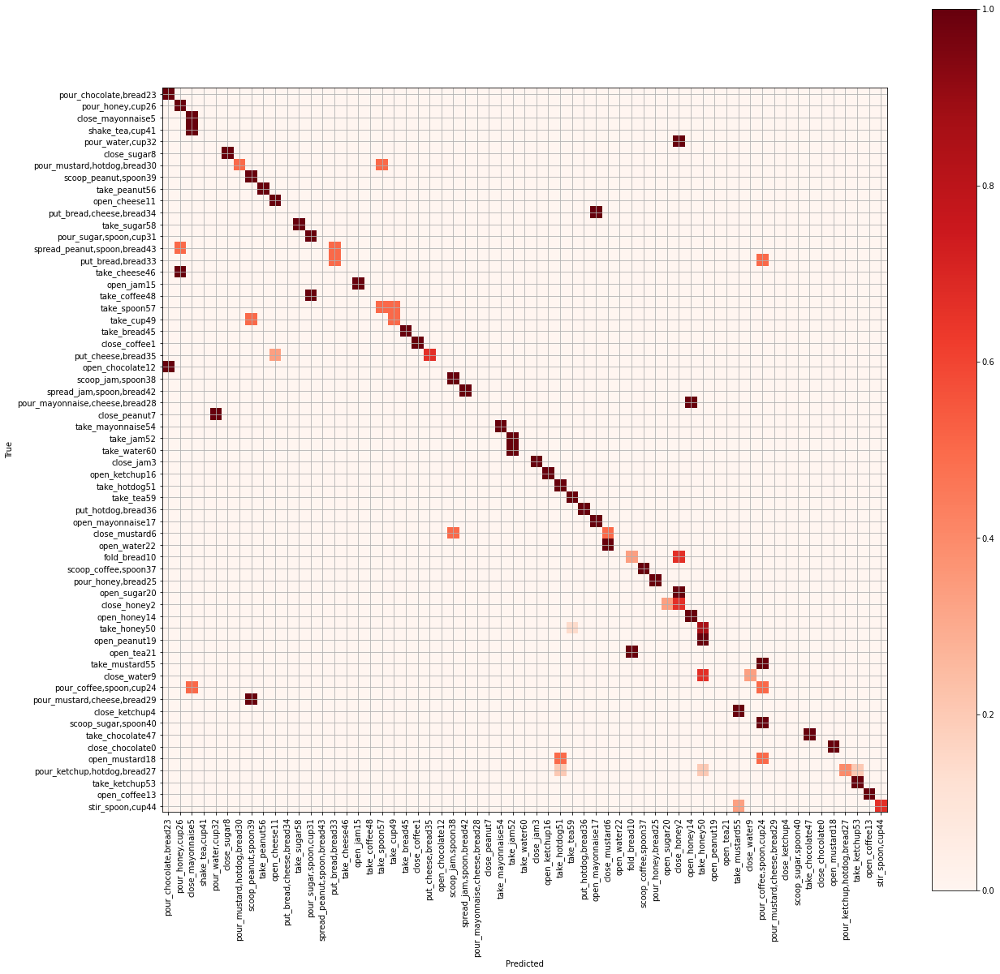

In [9]:
elements = ["--datasetDir", "./GTEA61_val",
            "--model_state_dict", "./cartella_RegselfSupGirodecayRate0.3_prova1/outDir/gtea61/regSelfSup/stage2/model_selfSup_state_dict.pth",
            "--seqLen", "7"]
ss.__main__(elements)